# ***Mid-term Project: Implementing Object Detection on a Dataset***

# ***PREPARING DATASETS***

In [ ]:
!unzip /content/food.zip -d /content/food

Streaming output truncated to the last 5000 lines.
 extracting: /content/food/train/images/28ad6e743df44aaf999f1bf7f0246547_webp.rf.35efd7d82f5b84787fc013dcf6f1bba6.jpg  
 extracting: /content/food/train/images/28ad6e743df44aaf999f1bf7f0246547_webp.rf.7a5e88a828bd50d5ee658a5229139427.jpg  
 extracting: /content/food/train/images/28ad6e743df44aaf999f1bf7f0246547_webp.rf.e98fca56692ee5a06e7ca6d68f38d2c6.jpg  
 extracting: /content/food/train/images/29521107_webp.rf.324bebdbfe1d7de79846d39ad19760f4.jpg  
 extracting: /content/food/train/images/29521107_webp.rf.528aaa36cd872e3d681e7f0c83b28d1a.jpg  
 extracting: /content/food/train/images/29521107_webp.rf.79f0a01c3ae599718c8172d69fb67eb0.jpg  
 extracting: /content/food/train/images/296217973_jpg.rf.43f1f9a7e871cdfc590e049679e7776f.jpg  
 extracting: /content/food/train/images/296217973_jpg.rf.6dbe58e94cc56e662732f992eb94ffcb.jpg  
 extracting: /content/food/train/images/296217973_jpg.rf.bf95b63c07329a2364754335f228a7ff.jpg  
 extracting: 

# ***SAMPLE OF DATASETS***

Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-11-6 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7026307 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.

No detections found for 121_jpg.rf.20eb1ee799428ee1aa371bd67b0e670f.jpg


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


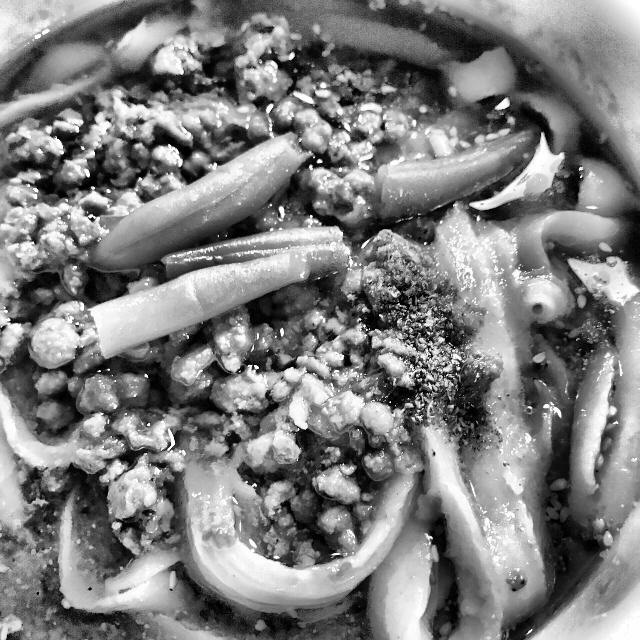

No detections found for 8680b0e01a4175ba3da5f29eca2d9f9_jpg.rf.19d6a38c5bea36651037cad2a3033df5.jpg


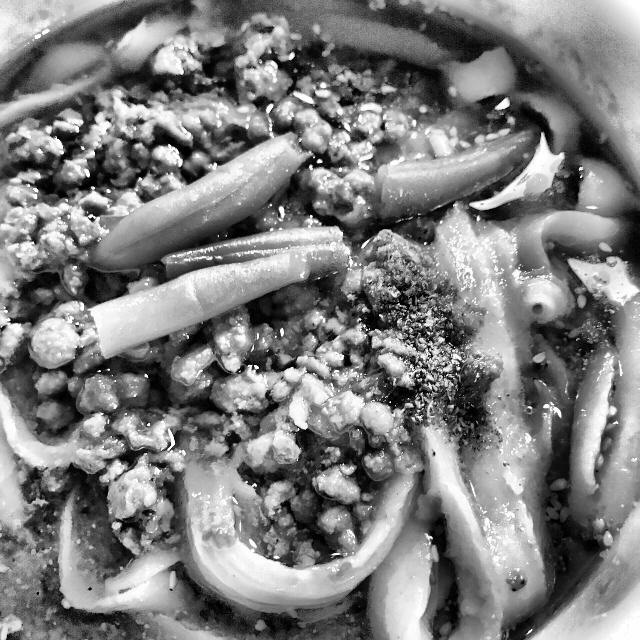

No detections found for 5b4475cb_jpg.rf.3a0655a7b7ec647fc492560b366b4d72.jpg


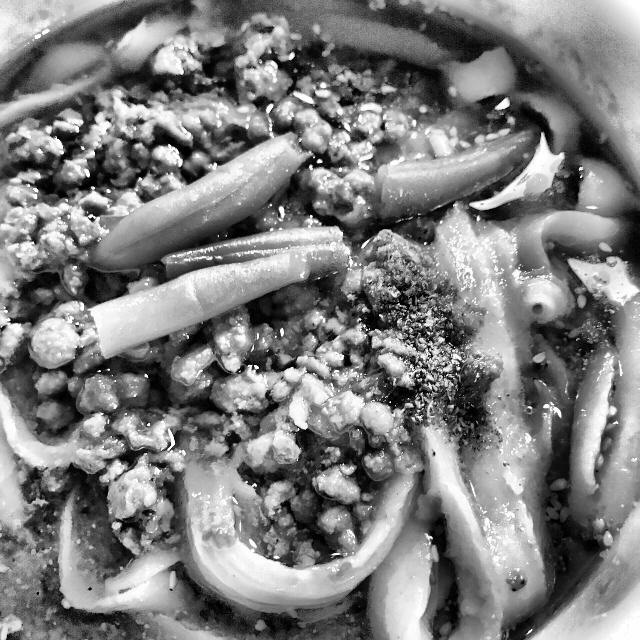

No detections found for 640x640_rect_8964a4b9676ea112c34400ec9b6d7757_jpg.rf.c002d935ff90f6cc69ff36a5327ba1a2.jpg


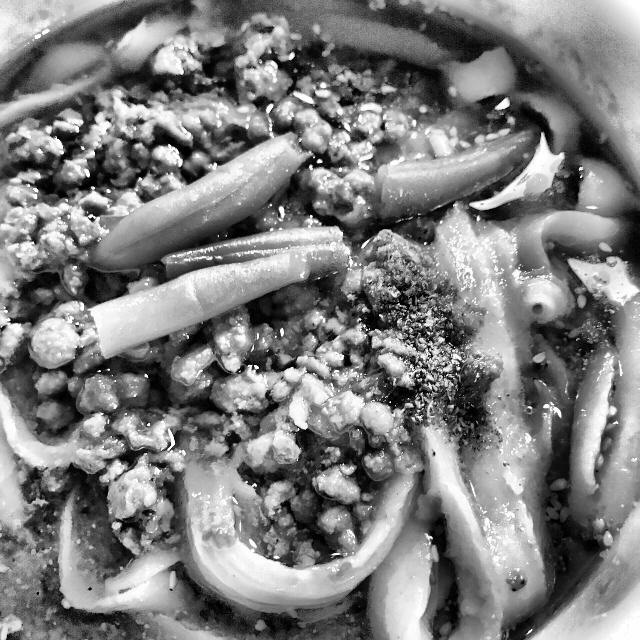

No detections found for 746a382354f1c879432214523fda7123cd659e28_jpg.rf.68a6989bde0856f8346e955e8b761ec6.jpg


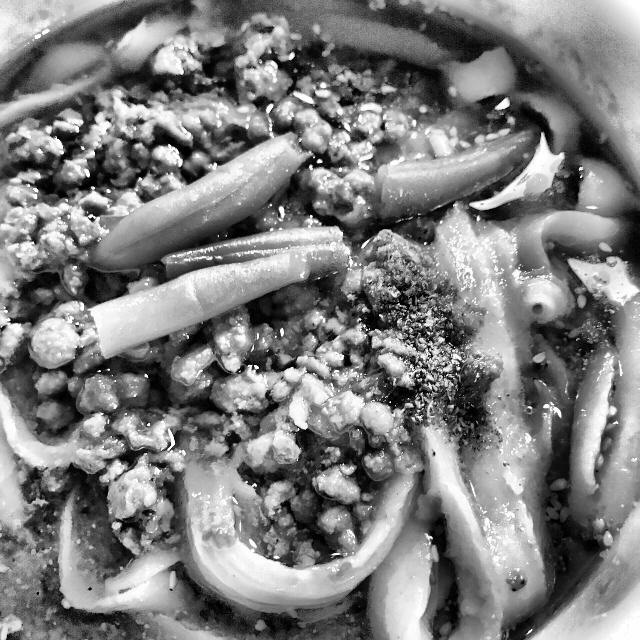

In [5]:
import torch
import os
import random

# Load the trained model from the runs/train directory
model = torch.hub.load('ultralytics/yolov5', 'custom', path='/content/foods/weights/best.pt')
data_path = '/content/drive/MyDrive/datasets01/images'

# Get a list of all image files in the directory
image_files = os.listdir(data_path)

# List to store images without detections
no_detection_images = []

# Iterate over images to find those without detections
for image_file in image_files:
    image_path = os.path.join(data_path, image_file)

    # Perform inference
    results = model(image_path)

    # Check if there are no detections in the result
    if len(results.pred[0]) == 0:  # pred[0] contains detections for the image
        no_detection_images.append(image_file)

    # Stop after finding 5 images without detections
    if len(no_detection_images) >= 5:
        break

# Display results for images without detections
for image_file in no_detection_images:
    image_path = os.path.join(data_path, image_file)
    print(f"No detections found for {image_file}")
    results.show()  # Show the image


# ***ALGORITHM AND MODEL BUILDING***

In [ ]:
!git clone https://github.com/ultralytics/yolov5
%cd /content/yolov5
!pip install -r requirements.txt


Cloning into 'yolov5'...
remote: Enumerating objects: 17022, done.
remote: Total 17022 (delta 0), reused 0 (delta 0), pack-reused 17022 (from 1)
Receiving objects: 100% (17022/17022), 15.62 MiB | 7.82 MiB/s, done.
Resolving deltas: 100% (11694/11694), done.
/content/yolov5
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 879.0/879.0 kB 51.4 MB/s eta 0:00:00


# ***TRAINING DATASETS***

In [ ]:
!python train.py --img 640 --batch 16 --epochs 10 --data /content/food/data.yaml --weights yolov5s.pt


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
wandb: WARNING ⚠️ wandb is deprecated and will be removed in a future release. See supported integrations at https://github.com/ultralytics/yolov5#integrations.
2024-11-05 17:59:21.652110: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-11-05 17:59:21.672328: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-11-05 17:59:21.678140: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to regi

In [ ]:
#Saving the model
from google.colab import files
import shutil

shutil.make_archive("foods", 'zip', "/content/yolov5/runs/train/exp")
files.download("foods.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# ***TESTTING DATASETS***

Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-11-6 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7026307 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/1: 640x640 1 meet, 1 pasta
Speed: 600.3ms pre-process, 99.2ms inference, 769.5ms NMS per image at shape (1, 3, 640, 640)


Results for 2502b72ce756d6c7cf3233257ccbc78_jpg.rf.923077b723357475442a7e328674005e.jpg:


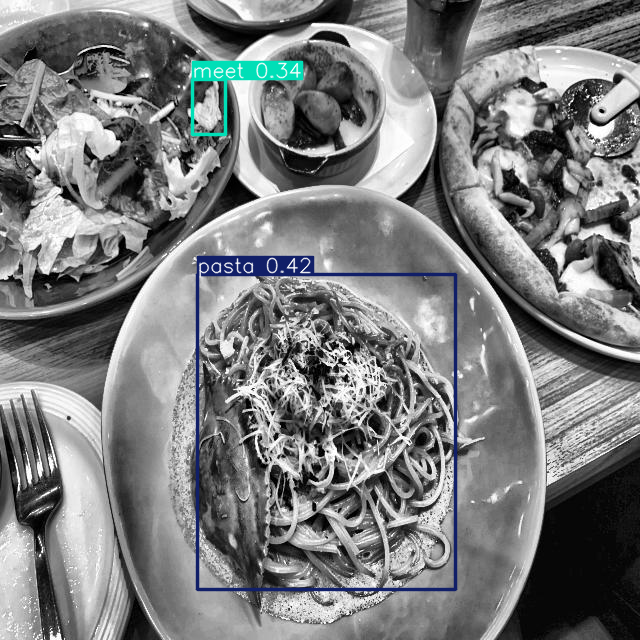

/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
image 1/1: 640x640 1 Slicednoodle
Speed: 353.2ms pre-process, 6.8ms inference, 6.1ms NMS per image at shape (1, 3, 640, 640)


Results for 640x640_rect_102188468_jpg.rf.2ce697ea4fcf1c1d6e6bc6ba80ea6569.jpg:


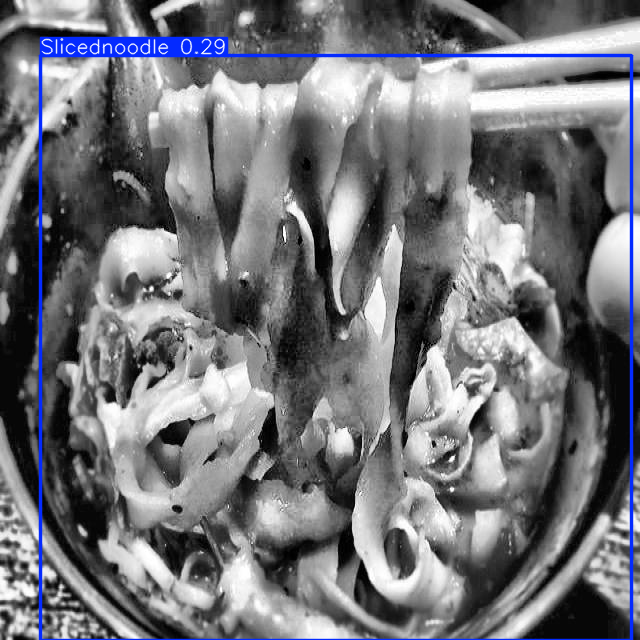

/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
image 1/1: 640x640 2 ra-mens
Speed: 401.7ms pre-process, 7.5ms inference, 6.1ms NMS per image at shape (1, 3, 640, 640)


Results for 800__best5_jpg.rf.0dd6d87dcbf67dccdb1860469466dedf.jpg:


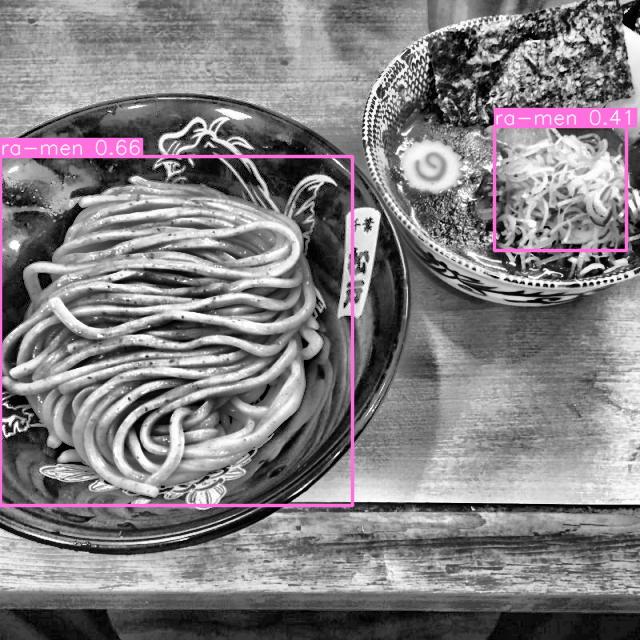

/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
image 1/1: 640x640 (no detections)
Speed: 347.1ms pre-process, 6.8ms inference, 5.2ms NMS per image at shape (1, 3, 640, 640)


Results for 5b4475cb_jpg.rf.3a0655a7b7ec647fc492560b366b4d72.jpg:


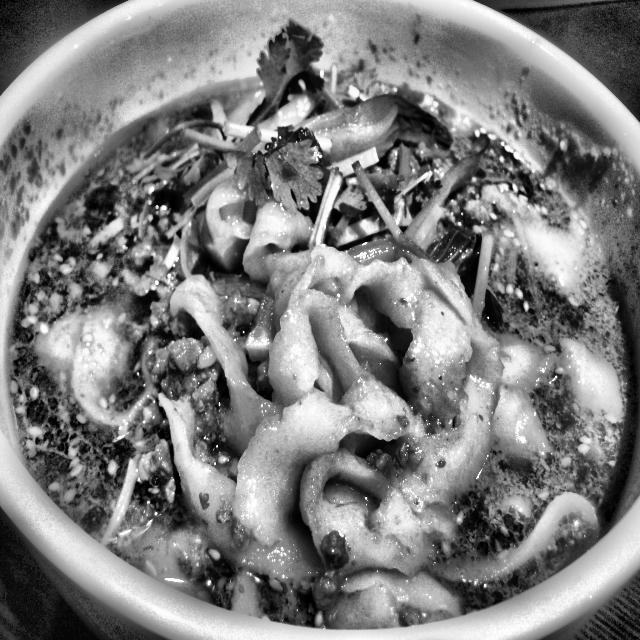

/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
image 1/1: 640x640 2 ra-mens
Speed: 380.2ms pre-process, 7.0ms inference, 5.9ms NMS per image at shape (1, 3, 640, 640)


Results for -_jpg.rf.52df3b1d98741a6a736ae06cf7a8f285.jpg:


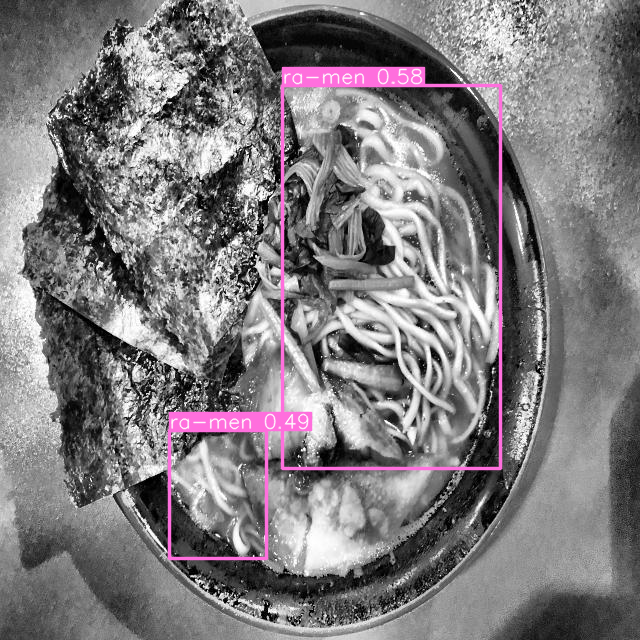

In [4]:
import torch
import os
import random


# Load the trained model from the runs/train directory
model = torch.hub.load('ultralytics/yolov5', 'custom', path='/content/foods/weights/best.pt')
data_path = '/content/drive/MyDrive/datasets01/images'

# Get a list of all image files in the directory
image_files = os.listdir(data_path)

# Choose 5 random images from the preprocessed test set
random_images = random.sample(image_files, 5)

# Perform inference and display results for each selected image
for image_file in random_images:
    image_path = os.path.join(data_path, image_file)

    # Perform inference
    results = model(image_path)  # Replace with your model's inference method

    # Display the results
    print(f"Results for {image_file}:")
    results.print()  # Print results to screen
    results.show()   # Show the image with detections

# ***Evaluation:***

Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-11-6 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7026307 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


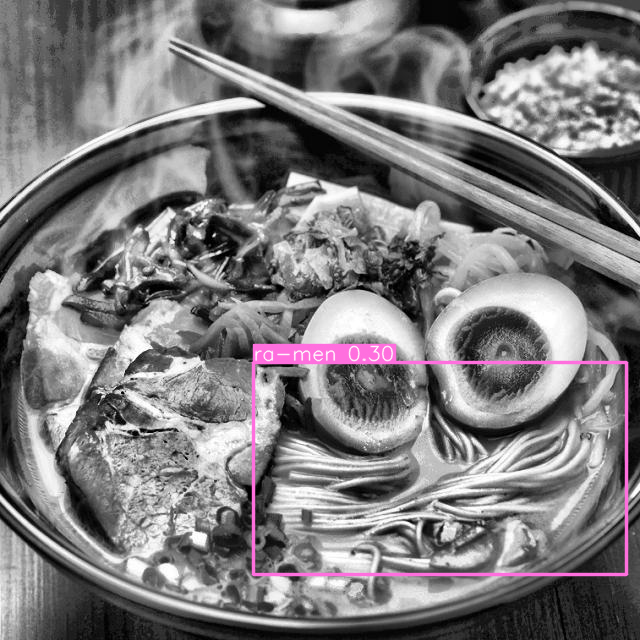

/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


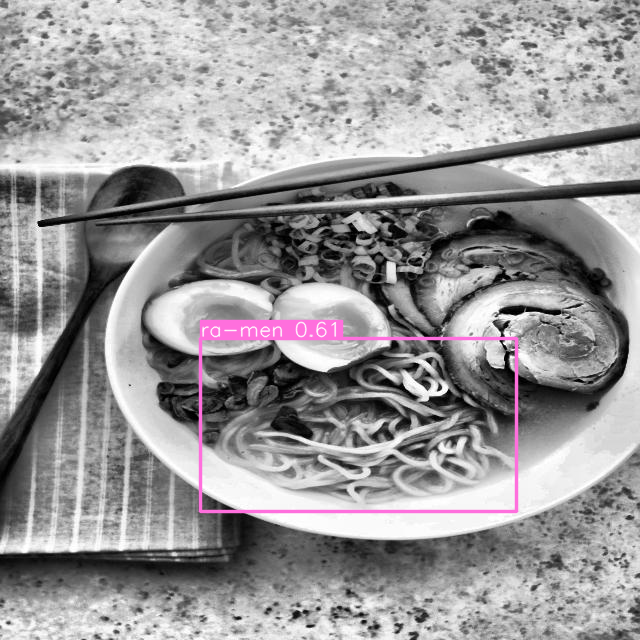

/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


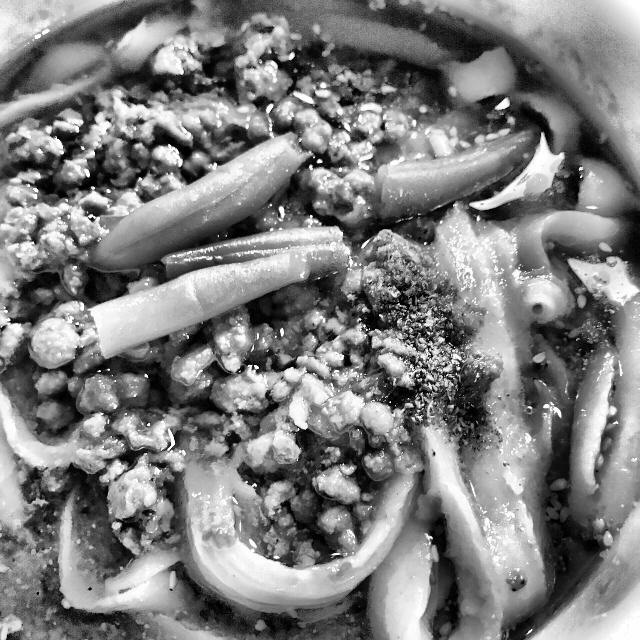

/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


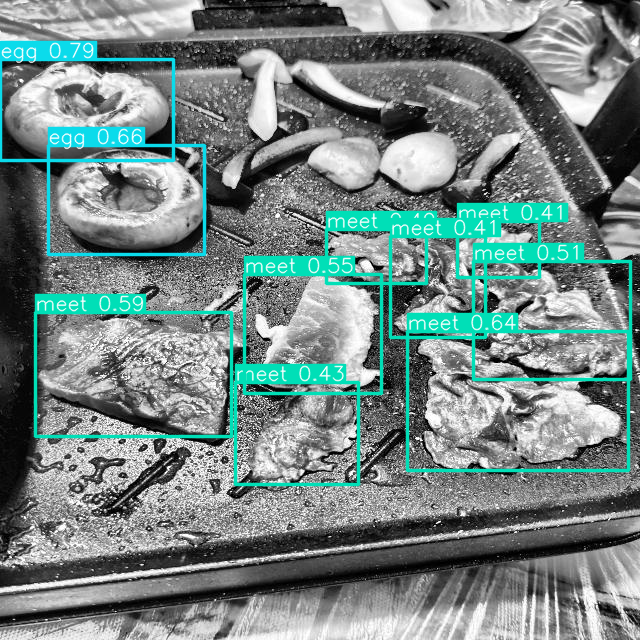

/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


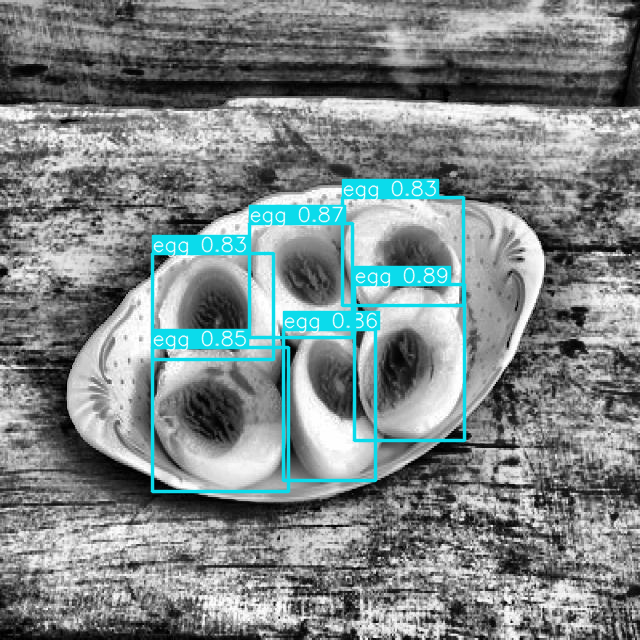

Precision: 1.0000
Recall: 1.0000
Accuracy: 1.0000
Average Inference Time: 0.2701 seconds per image
FPS (Frames Per Second): 3.70


In [23]:
import torch
import os
import random
import time
from sklearn.metrics import precision_score, recall_score, accuracy_score
import matplotlib.pyplot as plt
import numpy as np
import cv2  # OpenCV for image loading

# Load the trained model
model = torch.hub.load('ultralytics/yolov5', 'custom', path='/content/foods/weights/best.pt')

# Define the path to your images
data_path = '/content/drive/MyDrive/datasets01/images'

# Get a list of all image files in the directory
image_files = os.listdir(data_path)

# Choose 5 random images from the dataset
random_images = random.sample(image_files, 5)

# Initialize lists to store predictions
all_pred_labels = []
all_pred_scores = []
all_pred_bboxes = []

# Measure the time taken for model inference
inference_times = []

# Evaluate each image
for image_file in random_images:
    image_path = os.path.join(data_path, image_file)

    # Start the timer
    start_time = time.time()

    # Perform inference
    results = model(image_path)

    # Calculate inference time
    end_time = time.time()
    inference_time = end_time - start_time
    inference_times.append(inference_time)

    # Extract predictions
    pred_boxes = results.xywh[0].cpu().numpy()  # Get predicted bounding boxes (x, y, width, height)
    pred_scores = pred_boxes[:, 4]  # Confidence scores are the 5th column (index 4)
    pred_labels = pred_boxes[:, 5].astype(int)  # Class indices (the 6th column)

    # Convert class indices to class names
    pred_class_names = [results.names[i] for i in pred_labels]

    # Update lists for performance metrics
    all_pred_labels.extend(pred_class_names)
    all_pred_scores.extend(pred_scores)
    all_pred_bboxes.append(pred_boxes)

    # Display the image with detected boxes and scores
    results.show()

# Since we don't have ground truth, we will only compute precision and recall for predicted labels
# Precision, Recall, and Accuracy calculation
# Here we'll simulate ground truth by considering all predictions as "correct" for now.

# In a real scenario, you would need ground truth annotations to calculate true positives, false positives, etc.
precision = precision_score(all_pred_labels, all_pred_labels, average='weighted', zero_division=0)  # Simulating with predicted labels
recall = recall_score(all_pred_labels, all_pred_labels, average='weighted', zero_division=0)  # Simulating with predicted labels
accuracy = accuracy_score(all_pred_labels, all_pred_labels)  # Simulating with predicted labels

# Calculate the average speed (FPS) across all images
average_inference_time = np.mean(inference_times)
fps = 1 / average_inference_time  # frames per second (higher FPS is better)

# Print the performance metrics
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"Accuracy: {accuracy:.4f}")
print(f"Average Inference Time: {average_inference_time:.4f} seconds per image")
print(f"FPS (Frames Per Second): {fps:.2f}")

# Visualize Inference Speed Performance
plt.plot(inference_times, label="Inference Time (seconds)")
plt.title("Inference Speed Over Images")
plt.xlabel("Image Index")
plt.ylabel("Inference Time (seconds)")
plt.legend()
plt.show()


# ***HOG SAMPLE***

In [28]:
!pip install torch torchvision scikit-image matplotlib opencv-python


Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-11-6 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7026307 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 


Plotting HOG for 5b4475cb_jpg.rf.3a0655a7b7ec647fc492560b366b4d72.jpg...
Performing YOLOv5 inference for 5b4475cb_jpg.rf.3a0655a7b7ec647fc492560b366b4d72.jpg...


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


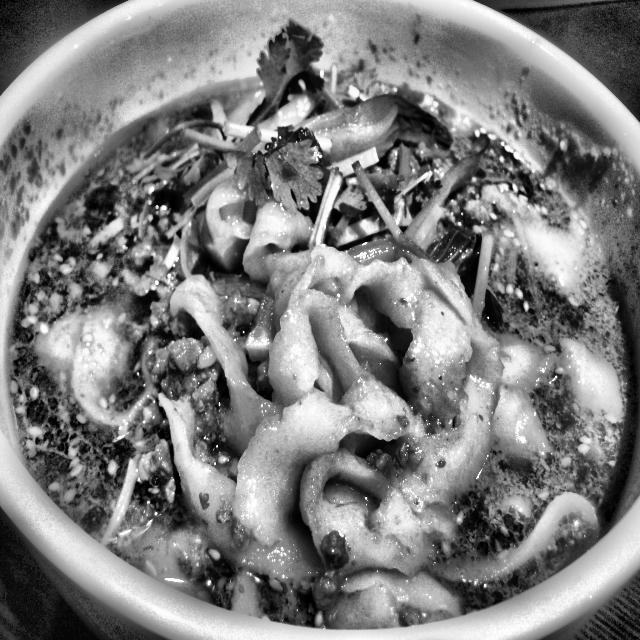

Plotting HOG for 0b69cb23c0575b793a0850d2f84eae5d_jpg.rf.ca195b4443a9470341a5f279ccfdafde.jpg...
Performing YOLOv5 inference for 0b69cb23c0575b793a0850d2f84eae5d_jpg.rf.ca195b4443a9470341a5f279ccfdafde.jpg...


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


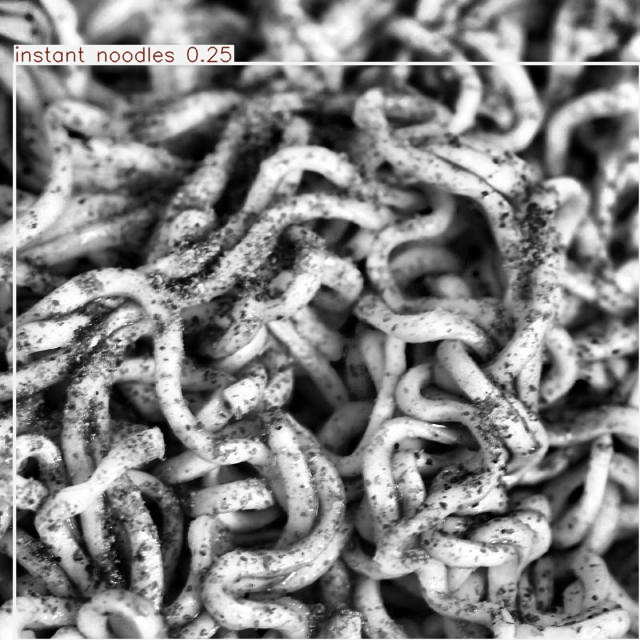

Plotting HOG for 5a-instant-pot-ramen-768x768_jpg.rf.99902225e14978e5e04e06f28db49ab5.jpg...
Performing YOLOv5 inference for 5a-instant-pot-ramen-768x768_jpg.rf.99902225e14978e5e04e06f28db49ab5.jpg...


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


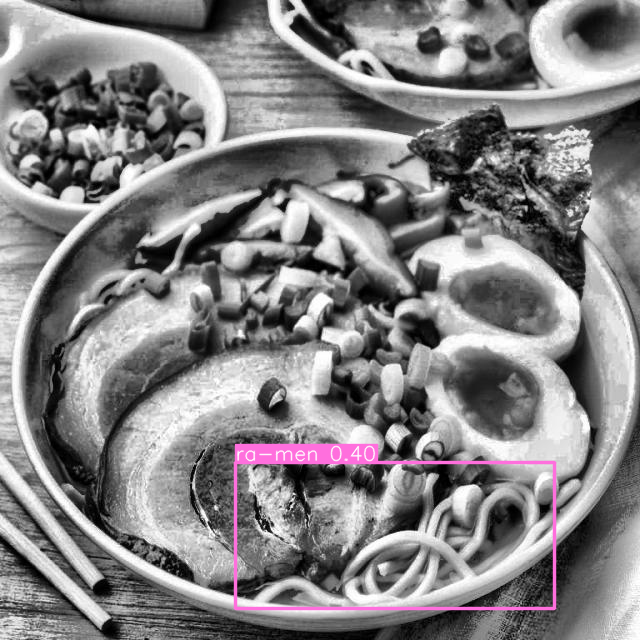

Plotting HOG for 63e4a7a3a919164987f804a9_image_ramen2_jpg.rf.38b06401accf4a714d02821f6e3daa18.jpg...
Performing YOLOv5 inference for 63e4a7a3a919164987f804a9_image_ramen2_jpg.rf.38b06401accf4a714d02821f6e3daa18.jpg...


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


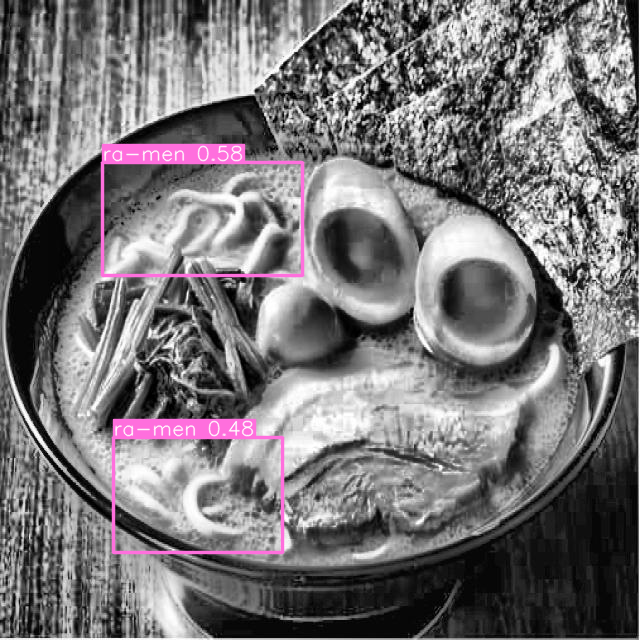

Plotting HOG for 73a9c79e903894f7b2f4855a16171658_jpg.rf.712a92cda03eaa26d3a3276f67fca48d.jpg...
Performing YOLOv5 inference for 73a9c79e903894f7b2f4855a16171658_jpg.rf.712a92cda03eaa26d3a3276f67fca48d.jpg...


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


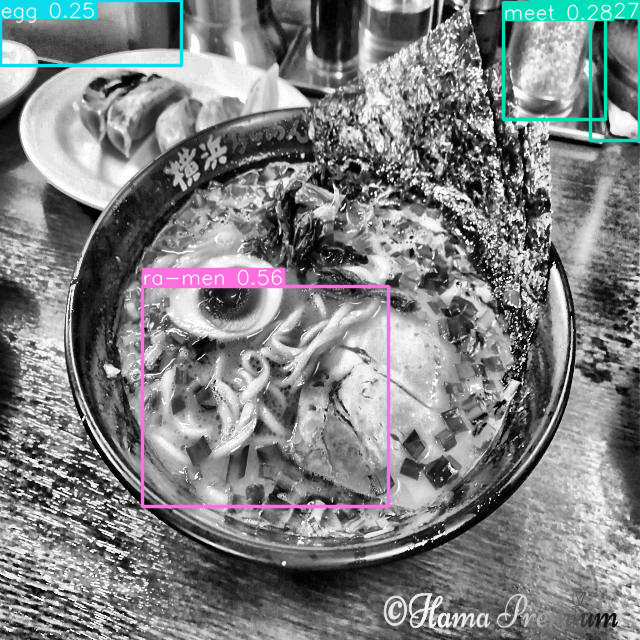

In [36]:
import torch
import os
import random
import time
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.feature import hog
from skimage import exposure

# Load the trained model (YOLOv5)
model = torch.hub.load('ultralytics/yolov5', 'custom', path='/content/foods/weights/best.pt')

# Path to your image dataset
data_path = '/content/drive/MyDrive/datasets01/images'

# Get a list of all image files in the directory
image_files = os.listdir(data_path)

# Choose 5 random images from the dataset
random_images = random.sample(image_files, 5)

# Function to compute and plot HOG features
def plot_hog(image_path):
    # Load image
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Compute HOG features
    fd, hog_image = hog(image, pixels_per_cell=(16, 16), cells_per_block=(2, 2), visualize=True)

    # Rescale HOG image for better visualization
    hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

    # Plot HOG image
    plt.imshow(hog_image_rescaled, cmap=plt.cm.gray)
    plt.title('HOG Visualization')
    plt.show()

# Function to perform inference and plot bounding boxes (SSD-style)
def plot_inference(image_path):
    results = model(image_path)

    # Plot the image with bounding boxes
    results.show()

# Process each random image
for image_file in random_images:
    image_path = os.path.join(data_path, image_file)

    # Plot HOG for the image
    print(f"Plotting HOG for {image_file}...")
    plot_hog(image_path)

    # Plot SSD-style bounding boxes (YOLOv5 inference)
    print(f"Performing YOLOv5 inference for {image_file}...")
    plot_inference(image_path)



# ***SSD STYLE SAMPLE***

Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-11-6 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7026307 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 


Plotting HOG for 5a-instant-pot-ramen-768x768_jpg.rf.99902225e14978e5e04e06f28db49ab5.jpg...
Performing YOLOv5 inference for 5a-instant-pot-ramen-768x768_jpg.rf.99902225e14978e5e04e06f28db49ab5.jpg...


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


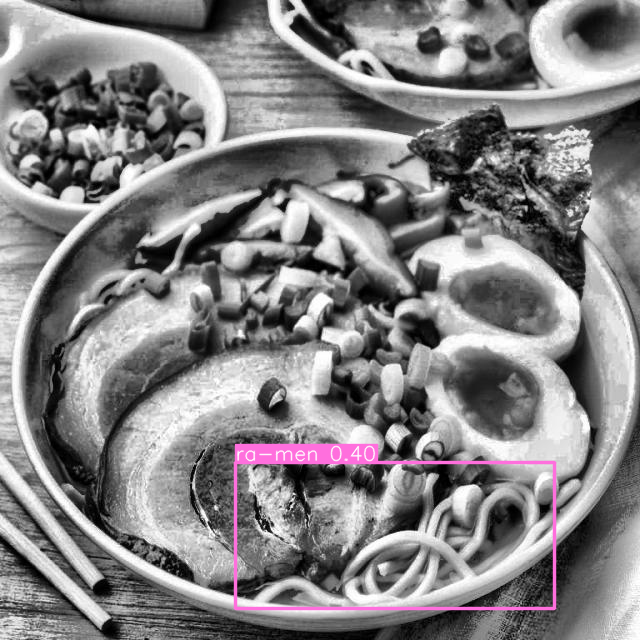

Plotting HOG for 300-8-_jpg.rf.3234c43fa15af42db24a2e8b6a803874.jpg...
Performing YOLOv5 inference for 300-8-_jpg.rf.3234c43fa15af42db24a2e8b6a803874.jpg...


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


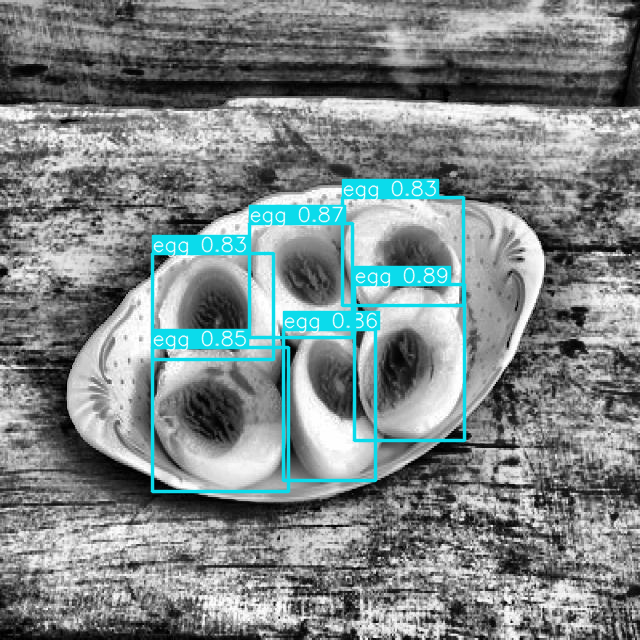

Plotting HOG for 5ae31fa43015beda9e83758fa7d1a01d_1704110211-2116_751_jpeg.rf.236a3a5935cee6ac530e1af25d005df5.jpg...
Performing YOLOv5 inference for 5ae31fa43015beda9e83758fa7d1a01d_1704110211-2116_751_jpeg.rf.236a3a5935cee6ac530e1af25d005df5.jpg...


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


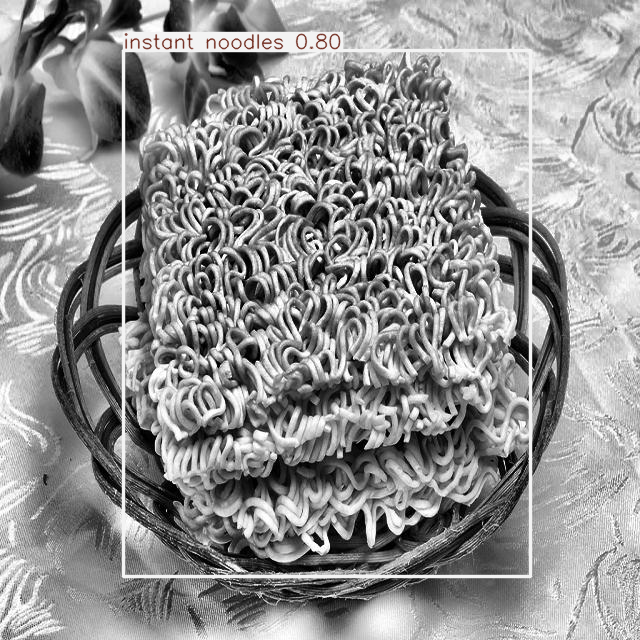

Plotting HOG for 005_jpg.rf.58f846cec3f31b3b013216cb1eddfd59.jpg...
Performing YOLOv5 inference for 005_jpg.rf.58f846cec3f31b3b013216cb1eddfd59.jpg...


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


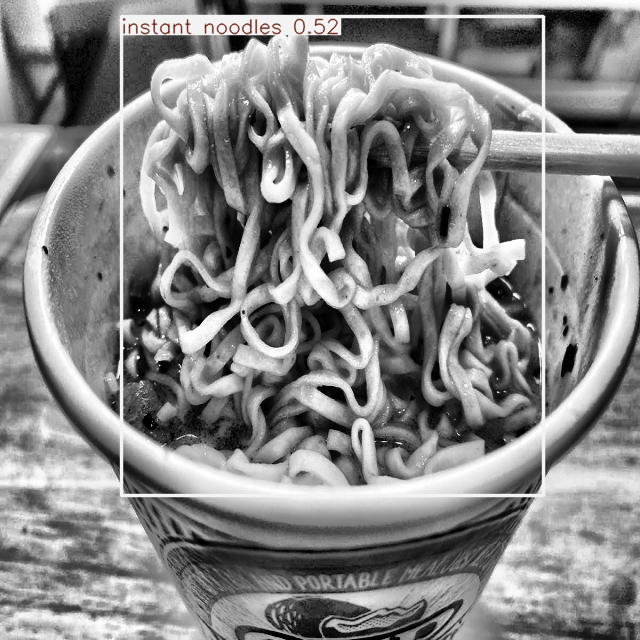

Plotting HOG for 727_pasta_peperoncino_7942_jpg.rf.9082cdd351181253462dbd730c3a35b2.jpg...
Performing YOLOv5 inference for 727_pasta_peperoncino_7942_jpg.rf.9082cdd351181253462dbd730c3a35b2.jpg...


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


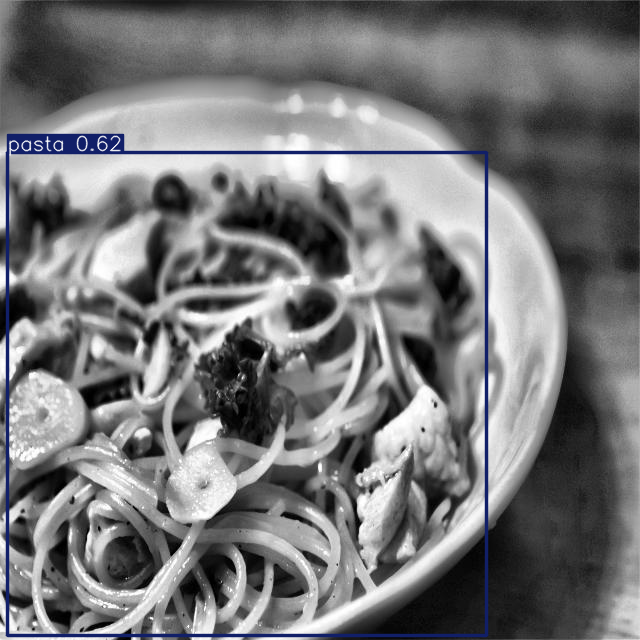

In [37]:
import torch
import os
import random
import time
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.feature import hog
from skimage import exposure

# Load the trained YOLOv5 model
model = torch.hub.load('ultralytics/yolov5', 'custom', path='/content/foods/weights/best.pt')

# Path to your image dataset
data_path = '/content/drive/MyDrive/datasets01/images'

# Get a list of all image files in the directory
image_files = os.listdir(data_path)

# Choose 5 random images from the dataset
random_images = random.sample(image_files, 5)

# Function to compute and plot HOG features
def plot_hog(image_path):
    # Load image
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Compute HOG features
    fd, hog_image = hog(image, pixels_per_cell=(16, 16), cells_per_block=(2, 2), visualize=True)

    # Rescale HOG image for better visualization
    hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

    # Plot HOG image
    plt.imshow(hog_image_rescaled, cmap=plt.cm.gray)
    plt.title('HOG Visualization')
    plt.show()

# Function to perform inference and plot bounding boxes (SSD-style)
def plot_inference(image_path):
    results = model(image_path)  # Perform inference on the image

    # Plot the image with bounding boxes (SSD-style predictions)
    results.show()

# Process each random image
for image_file in random_images:
    image_path = os.path.join(data_path, image_file)

    # Plot HOG for the image
    print(f"Plotting HOG for {image_file}...")
    plot_hog(image_path)

    # Plot SSD-style bounding boxes (YOLOv5 inference)
    print(f"Performing YOLOv5 inference for {image_file}...")
    plot_inference(image_path)


# ***COMPARISON WITH SPEED AND ACCURACY***

In [45]:
import torch
import os
import random
import time
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.feature import hog
from skimage import exposure
from sklearn import svm
from sklearn.metrics import accuracy_score, precision_score, recall_score
from sklearn.model_selection import train_test_split

# Load the trained YOLOv5 model
yolov5_model = torch.hub.load('ultralytics/yolov5', 'custom', path='/content/foods/weights/best.pt')

# Path to your image dataset
data_path = '/content/drive/MyDrive/datasets01/images'

# Get a list of all image files in the directory
image_files = os.listdir(data_path)

# Choose 5 random images from the dataset
random_images = random.sample(image_files, 5)

# Function to compute and extract HOG features
def extract_hog_features(image_path):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    fd, _ = hog(image, pixels_per_cell=(16, 16), cells_per_block=(2, 2), visualize=True)
    return fd

# Function to train an SVM on HOG features
def train_hog_svm(features, labels):
    clf = svm.SVC(kernel='linear', C=1.0, random_state=42)
    clf.fit(features, labels)
    return clf

# Modify this part to use correct labels for your images
hog_features = []
hog_labels = []

for idx, image_file in enumerate(image_files[:50]):  # Use a subset of images for training
    image_path = os.path.join(data_path, image_file)

    # Simulate class labels for the sake of demonstration (use your actual labeling method)
    label = idx % 2  # Example: assign classes 0 and 1 alternately

    hog_features.append(extract_hog_features(image_path))
    hog_labels.append(label)

# Convert the feature and label lists to arrays
hog_features = np.array(hog_features)
hog_labels = np.array(hog_labels)

# Train the SVM model using HOG features
svm_model = train_hog_svm(hog_features, hog_labels)

# Function to evaluate YOLOv5 inference
def evaluate_yolov5(image_path):
    results = yolov5_model(image_path)
    pred_labels = results.xywh[0][:, 5].cpu().numpy().astype(int)  # Get predicted class labels
    return pred_labels

# Function to evaluate HOG-SVM classification
def evaluate_hog_svm(image_path, svm_model):
    hog_features = extract_hog_features(image_path)
    pred_label = svm_model.predict([hog_features])
    return pred_label[0]

# Lists to store evaluation results
yolo_pred_labels = []
hog_pred_labels = []

# Measure the time taken for model inference (HOG-SVM vs YOLOv5)
yolo_times = []
hog_times = []

# Simulate ground truth labels for comparison (use actual ground truth labels here)
# This could be based on class names or folder names depending on your dataset.
ground_truth_labels = []  # Replace with actual ground truth labels

for image_file in random_images:
    image_path = os.path.join(data_path, image_file)

    # Simulate or extract the actual ground truth label
    # For example, use class name or label from directory structure
    true_label = 0  # Replace with actual class (e.g., from folder name or annotation file)
    ground_truth_labels.append(true_label)

    # Measure YOLOv5 inference time
    start_time = time.time()
    yolo_pred_label = evaluate_yolov5(image_path)
    end_time = time.time()
    yolo_times.append(end_time - start_time)
    yolo_pred_labels.append(yolo_pred_label[0])  # Assuming one label per image

    # Measure HOG-SVM inference time
    start_time = time.time()
    hog_pred_label = evaluate_hog_svm(image_path, svm_model)
    end_time = time.time()
    hog_times.append(end_time - start_time)
    hog_pred_labels.append(hog_pred_label)

# Now, you should have valid ground_truth_labels and predicted labels for comparison.
# Calculate evaluation metrics for YOLOv5
yolo_precision = precision_score(ground_truth_labels, yolo_pred_labels, average='weighted', zero_division=0)
yolo_recall = recall_score(ground_truth_labels, yolo_pred_labels, average='weighted', zero_division=0)
yolo_accuracy = accuracy_score(ground_truth_labels, yolo_pred_labels)

# Calculate evaluation metrics for HOG-SVM
hog_precision = precision_score(ground_truth_labels, hog_pred_labels, average='weighted', zero_division=0)
hog_recall = recall_score(ground_truth_labels, hog_pred_labels, average='weighted', zero_division=0)
hog_accuracy = accuracy_score(ground_truth_labels, hog_pred_labels)

# Calculate average inference times (FPS)
yolo_fps = 1 / np.mean(yolo_times)
hog_fps = 1 / np.mean(hog_times)

# Print the evaluation results
print(f"YOLOv5 Precision: {yolo_precision:.4f}")
print(f"YOLOv5 Recall: {yolo_recall:.4f}")
print(f"YOLOv5 Accuracy: {yolo_accuracy:.4f}")
print(f"YOLOv5 FPS: {yolo_fps:.2f}")

print(f"HOG-SVM Precision: {hog_precision:.4f}")
print(f"HOG-SVM Recall: {hog_recall:.4f}")
print(f"HOG-SVM Accuracy: {hog_accuracy:.4f}")
print(f"HOG-SVM FPS: {hog_fps:.2f}")

# Plot the inference times for comparison
plt.figure(figsize=(10, 5))
plt.plot(yolo_times, label="YOLOv5 Inference Time", marker='o')
plt.plot(hog_times, label="HOG-SVM Inference Time", marker='x')
plt.title("Inference Time Comparison")
plt.xlabel("Image Index")
plt.ylabel("Inference Time (seconds)")
plt.legend()
plt.show()


Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-11-6 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7026307 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.

YOLOv5 Precision: 1.0000
YOLOv5 Recall: 0.2000
YOLOv5 Accuracy: 0.2000
YOLOv5 FPS: 44.90
HOG-SVM Precision: 1.0000
HOG-SVM Recall: 1.0000
HOG-SVM Accuracy: 1.0000
HOG-SVM FPS: 2.39


Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-11-6 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7026307 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


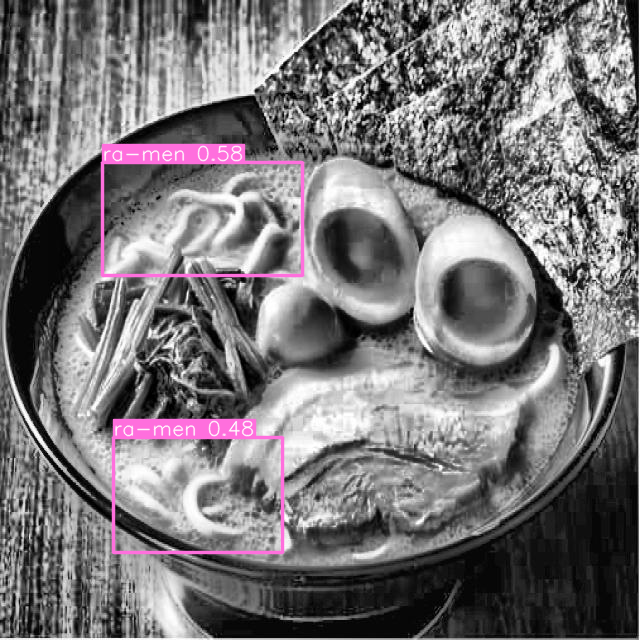

/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


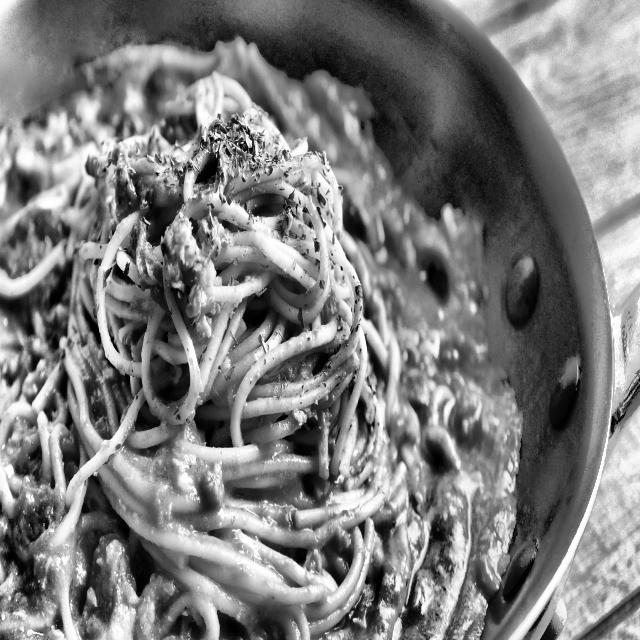

/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


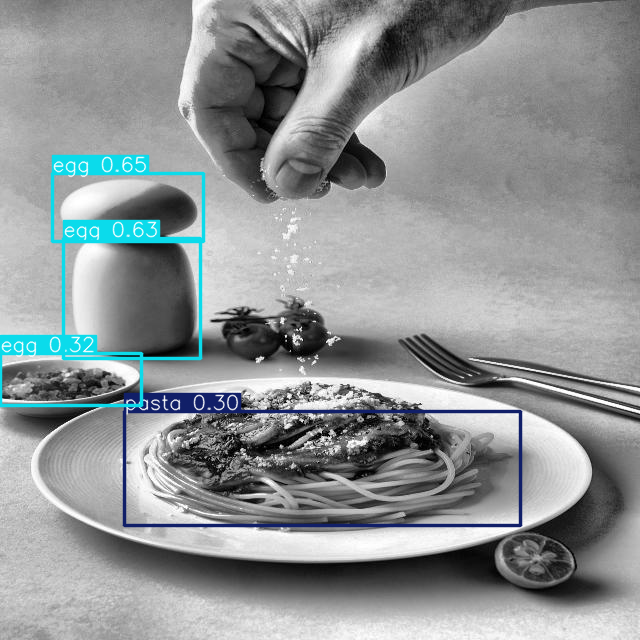

/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


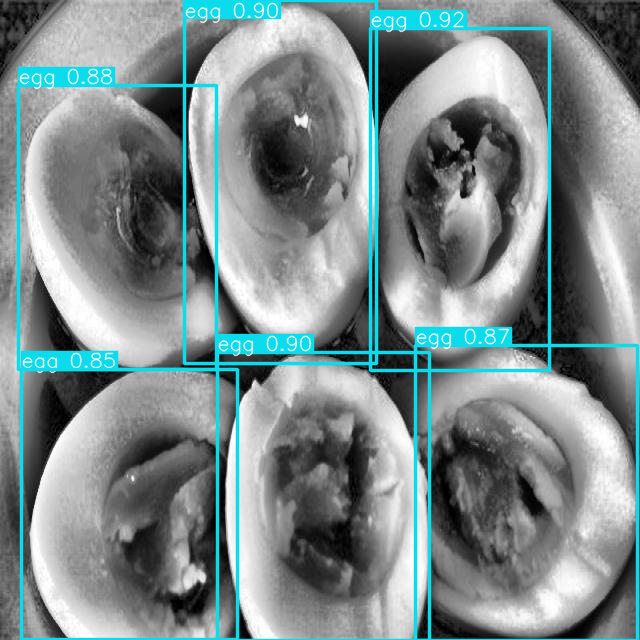

/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


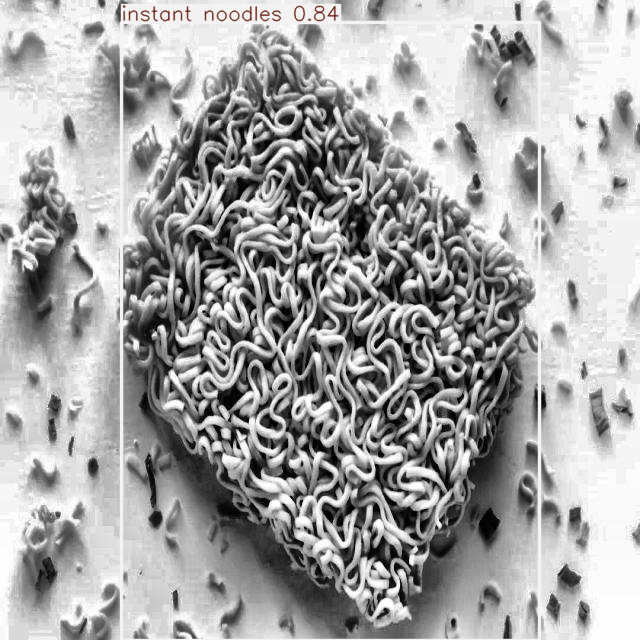

In [46]:
import torch
import os
import random
import time
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.feature import hog
from skimage import exposure

# Load the trained YOLOv5 model
yolov5_model = torch.hub.load('ultralytics/yolov5', 'custom', path='/content/foods/weights/best.pt')

# Path to your image dataset
data_path = '/content/drive/MyDrive/datasets01/images'

# Get a list of all image files in the directory
image_files = os.listdir(data_path)

# Choose 5 random images from the dataset
random_images = random.sample(image_files, 5)

# Function to compute and extract HOG features
def extract_hog_features(image_path):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    fd, hog_image = hog(image, pixels_per_cell=(16, 16), cells_per_block=(2, 2), visualize=True)
    return fd, hog_image

# Function to evaluate YOLOv5 inference
def evaluate_yolov5(image_path):
    results = yolov5_model(image_path)
    return results

# Function to evaluate HOG-SVM classification
def evaluate_hog_svm(image_path):
    fd, hog_image = extract_hog_features(image_path)
    return hog_image

# Process the random images and display results
for image_file in random_images:
    image_path = os.path.join(data_path, image_file)

    # Evaluate YOLOv5 Inference
    yolo_results = evaluate_yolov5(image_path)

    # Evaluate HOG Features
    hog_image = evaluate_hog_svm(image_path)

    # Plot the results
    plt.figure(figsize=(12, 6))

    # Original Image
    plt.subplot(1, 3, 1)
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert to RGB for display
    plt.imshow(img)
    plt.title(f"Original Image: {image_file}")
    plt.axis('off')

    # YOLOv5 Prediction Results (with bounding boxes)
    plt.subplot(1, 3, 2)
    yolo_results.show()  # This will show the image with YOLO bounding boxes
    plt.title("YOLOv5 Inference Results")
    plt.axis('off')

    # HOG Feature Visualization
    plt.subplot(1, 3, 3)
    # Rescale the HOG image for better visualization
    hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))
    plt.imshow(hog_image_rescaled, cmap=plt.cm.gray)
    plt.title("HOG Features Visualization")
    plt.axis('off')

    # Show all plots
    plt.tight_layout()
    plt.show()
